This notebook was made by: Lesly Carolina Guerrero Vélez

On: February 17, 2024.

University of Essex, Colchester.


In [27]:
#import libraries
import pandas as pd
import matplotlib.pyplot as plt
import plotly.express as px
import seaborn as sns
from statsmodels.tsa.seasonal import seasonal_decompose
from statsmodels.tsa.stattools import adfuller
from statsmodels.graphics.tsaplots import plot_acf, plot_pacf
import numpy as np

from windpowerlib import ModelChain, WindTurbine
from windpowerlib import data as wt

#ignore warnings
import warnings
warnings.filterwarnings("ignore")

## Cleaning data

Now that we have append our csv files into one is time to clean the data

In [22]:
#read colchester data from csv
colchester_df = pd.read_csv("data/colchester.csv",parse_dates=['datetime'])
colchester_df.head()

,datetime,temp,dew,humidity,precip,precipprob,preciptype,snow,snowdepth,windspeed,winddir,sealevelpressure,cloudcover,solarradiation,solarenergy,uvindex
0,2006-06-19T00:00:00,17.9,13.3,74.46,0.0,0.0,NaN,0.0,0.0,13.3,198.0,1008.9,90.0,NaN,NaN,NaN
1,2006-06-19T01:00:00,17.5,13.2,75.98,0.0,0.0,NaN,0.0,0.0,14.1,206.0,1008.9,90.0,NaN,NaN,NaN
2,2006-06-19T02:00:00,16.8,12.5,75.81,0.0,0.0,NaN,0.0,0.0,13.9,210.0,1008.0,90.0,NaN,NaN,NaN
3,2006-06-19T03:00:00,16.0,11.4,74.35,0.0,0.0,NaN,0.0,0.0,12.5,221.0,1007.9,90.0,NaN,NaN,NaN
4,2006-06-19T04:00:00,15.2,9.7,69.46,0.0,0.0,NaN,0.0,0.0,13.8,214.0,1007.9,26.6,NaN,NaN,NaN


In [19]:
print("Number of colchester samples: ",colchester_df.shape[0])

Number of colchester samples:  295846


In [20]:
#check data types
print("colchester data types: ",colchester_df.dtypes)

colchester data types:  datetime            object
temp                object
dew                 object
humidity            object
precip              object
precipprob          object
preciptype          object
snow                object
snowdepth           object
windspeed           object
winddir             object
sealevelpressure    object
cloudcover          object
solarradiation      object
solarenergy         object
uvindex             object
dtype: object


In [11]:
#bring colums that contain letters in data and show what strings are those
for column in colchester_df.columns:
    #if an element of the unique list contains any letter print it
    if column != 'datetime':
        words=[element for element in colchester_df[column].unique() if any(char.isalpha() for char in str(element))]
        print("Column: ",column,"contains: ", words)


Column:  temp contains:  [nan, 'temp']
Column:  dew contains:  [nan, 'dew']
Column:  humidity contains:  [nan, 'humidity']
Column:  precip contains:  [nan, 'precip']
Column:  precipprob contains:  [nan, 'precipprob']
Column:  preciptype contains:  [nan, 'rain', 'preciptype', 'rain,snow', 'snow']
Column:  snow contains:  [nan, 'snow']
Column:  snowdepth contains:  [nan, 'snowdepth']
Column:  windspeed contains:  [nan, 'windspeed']
Column:  winddir contains:  [nan, 'winddir']
Column:  sealevelpressure contains:  [nan, 'sealevelpressure']
Column:  cloudcover contains:  [nan, 'cloudcover']
Column:  solarradiation contains:  [nan, 'solarradiation']
Column:  solarenergy contains:  [nan, 'solarenergy', 'uvindex']
Column:  uvindex contains:  [nan, 'uvindex']


In [12]:
#print the unique rows that contains the word "temp" in the column "temp"
temp_rows = colchester_df[colchester_df['temp'].str.contains("temp", na=False)]
unique_temp_rows = temp_rows.drop_duplicates()
print(unique_temp_rows)


        datetime  temp  dew  humidity  precip  precipprob  preciptype  snow  \
960     datetime  temp  dew  humidity  precip  precipprob  preciptype  snow   
177726  datetime  temp  dew  humidity  precip  precipprob  preciptype  snow   

        snowdepth  windspeed  winddir  sealevelpressure  cloudcover  \
960     snowdepth  windspeed  winddir  sealevelpressure  cloudcover   
177726  snowdepth  windspeed  winddir  sealevelpressure  cloudcover   

        solarradiation  solarenergy  uvindex  
960     solarradiation  solarenergy  uvindex  
177726  solarradiation      uvindex      NaN  


In [13]:
#drop row from colchester_df that contains the word "temp" in the column "temp"
colchester_df = colchester_df[~colchester_df['temp'].str.contains("temp", na=False)]


We also have rows with wrong numeric values, lets remove them

In [14]:
# see rows with preciptype == 6
colchester_df[colchester_df['preciptype']== "6"]


,datetime,temp,dew,humidity,precip,precipprob,preciptype,snow,snowdepth,windspeed,winddir,sealevelpressure,cloudcover,solarradiation,solarenergy,uvindex
3843,0,1,2,3,4,5,6,7,8,9,10,11,12,13,14,15
6726,0,1,2,3,4,5,6,7,8,9,10,11,12,13,14,15
9610,0,1,2,3,4,5,6,7,8,9,10,11,12,13,14,15
11532,0,1,2,3,4,5,6,7,8,9,10,11,12,13,14,15
13455,0,1,2,3,4,5,6,7,8,9,10,11,12,13,14,15
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
291036,0,1,2,3,4,5,6,7,8,9,10,11,12,13,14,15
291998,0,1,2,3,4,5,6,7,8,9,10,11,12,13,14,15
292960,0,1,2,3,4,5,6,7,8,9,10,11,12,13,14,15
293922,0,1,2,3,4,5,6,7,8,9,10,11,12,13,14,15


In [23]:
#remove rows with preciptype = 6
colchester_df = colchester_df[colchester_df['preciptype'] != "6"]

In [24]:
#change datatypes of columns all columns to float except datetime they are in format "5.7",...
colchester_df = colchester_df.apply(pd.to_numeric, errors='ignore')

In [17]:
print("Colchester data types: ",colchester_df.dtypes)


Colchester data types:  datetime             object
temp                float64
dew                 float64
humidity            float64
precip              float64
precipprob          float64
preciptype           object
snow                float64
snowdepth           float64
windspeed           float64
winddir             float64
sealevelpressure    float64
cloudcover          float64
solarradiation      float64
solarenergy         float64
uvindex             float64
dtype: object


In [18]:
print("Colchester missing values: ",colchester_df.isnull().sum())


Colchester missing values:  datetime                 0
temp                   642
dew                    681
humidity               679
precip                 930
precipprob             683
preciptype          265257
snow                  1805
snowdepth             1891
windspeed              635
winddir                669
sealevelpressure     11813
cloudcover            4966
solarradiation      144948
solarenergy         144913
uvindex             144924
dtype: int64


We have many missing values in solar variables, we are going to avoid the use of them

In [19]:
# check id there are duplicated rows
duplicated_rows = colchester_df[colchester_df.duplicated()]
print("Duplicated rows: ",duplicated_rows)

Duplicated rows:                     datetime  temp   dew  humidity  precip  precipprob  \
24034   2006-06-19T00:00:00  17.9  13.3     74.46     0.0         0.0   
24035   2006-06-19T01:00:00  17.5  13.2     75.98     0.0         0.0   
24036   2006-06-19T02:00:00  16.8  12.5     75.81     0.0         0.0   
24037   2006-06-19T03:00:00  16.0  11.4     74.35     0.0         0.0   
24038   2006-06-19T04:00:00  15.2   9.7     69.46     0.0         0.0   
...                     ...   ...   ...       ...     ...         ...   
295841  2009-07-12T19:00:00  21.4  11.0     51.47     0.0         0.0   
295842  2009-07-12T20:00:00  20.4  10.6     53.54     0.0         0.0   
295843  2009-07-12T21:00:00  18.2  10.6     61.35     0.0         0.0   
295844  2009-07-12T22:00:00  16.5  11.6     73.08     0.0         0.0   
295845  2009-07-12T23:00:00  15.1  12.3     83.21     0.0         0.0   

       preciptype  snow  snowdepth  windspeed  winddir  sealevelpressure  \
24034         NaN   0.0      

In [20]:
#remove rows with datetime = 0
colchester_df = colchester_df[colchester_df['datetime'] != "0"]
print("Number of colchester samples: ",colchester_df.shape[0])

Number of colchester samples:  295540


We are done with numerical variables, Now lets clean categorical variables.

In [21]:
# see values of categeorical column preciptype
print("PrecipType values: ",colchester_df['preciptype'].unique())


PrecipType values:  [nan 'rain' 'rain,snow' 'snow']


In [22]:
# create dummy variables for categorical column preciptype and add them to the dataframe for the value "rain,snow" separate them into two columns(so at the end i will just have column snow and column rain)
# split the combined categories into separate categories
colchester_df['preciptype_rain'] = colchester_df['preciptype'].str.contains('rain')
colchester_df['preciptype_snow'] = colchester_df['preciptype'].str.contains('snow')
colchester_df.head()


,datetime,temp,dew,humidity,precip,precipprob,preciptype,snow,snowdepth,windspeed,winddir,sealevelpressure,cloudcover,solarradiation,solarenergy,uvindex,preciptype_rain,preciptype_snow
0,2006-06-19T00:00:00,17.9,13.3,74.46,0.0,0.0,NaN,0.0,0.0,13.3,198.0,1008.9,90.0,NaN,NaN,NaN,NaN,NaN
1,2006-06-19T01:00:00,17.5,13.2,75.98,0.0,0.0,NaN,0.0,0.0,14.1,206.0,1008.9,90.0,NaN,NaN,NaN,NaN,NaN
2,2006-06-19T02:00:00,16.8,12.5,75.81,0.0,0.0,NaN,0.0,0.0,13.9,210.0,1008.0,90.0,NaN,NaN,NaN,NaN,NaN
3,2006-06-19T03:00:00,16.0,11.4,74.35,0.0,0.0,NaN,0.0,0.0,12.5,221.0,1007.9,90.0,NaN,NaN,NaN,NaN,NaN
4,2006-06-19T04:00:00,15.2,9.7,69.46,0.0,0.0,NaN,0.0,0.0,13.8,214.0,1007.9,26.6,NaN,NaN,NaN,NaN,NaN


In [23]:
#fillna for preciptype_rain and preciptype_snow witht the value False
colchester_df['preciptype_rain'] = colchester_df['preciptype_rain'].fillna(False)  
colchester_df['preciptype_snow'] = colchester_df['preciptype_snow'].fillna(False)
colchester_df.head()

,datetime,temp,dew,humidity,precip,precipprob,preciptype,snow,snowdepth,windspeed,winddir,sealevelpressure,cloudcover,solarradiation,solarenergy,uvindex,preciptype_rain,preciptype_snow
0,2006-06-19T00:00:00,17.9,13.3,74.46,0.0,0.0,NaN,0.0,0.0,13.3,198.0,1008.9,90.0,NaN,NaN,NaN,False,False
1,2006-06-19T01:00:00,17.5,13.2,75.98,0.0,0.0,NaN,0.0,0.0,14.1,206.0,1008.9,90.0,NaN,NaN,NaN,False,False
2,2006-06-19T02:00:00,16.8,12.5,75.81,0.0,0.0,NaN,0.0,0.0,13.9,210.0,1008.0,90.0,NaN,NaN,NaN,False,False
3,2006-06-19T03:00:00,16.0,11.4,74.35,0.0,0.0,NaN,0.0,0.0,12.5,221.0,1007.9,90.0,NaN,NaN,NaN,False,False
4,2006-06-19T04:00:00,15.2,9.7,69.46,0.0,0.0,NaN,0.0,0.0,13.8,214.0,1007.9,26.6,NaN,NaN,NaN,False,False


In [24]:
# replace true and false with 1 and 0
colchester_df['preciptype_rain'] = colchester_df['preciptype_rain'].astype(int)
colchester_df['preciptype_snow'] = colchester_df['preciptype_snow'].astype(int)
#remove column preciptype
colchester_df = colchester_df.drop(columns=['preciptype'])

In [25]:
#order data by datetime and use datetime as index
colchester_df = colchester_df.sort_values(by='datetime')
colchester_df = colchester_df.set_index('datetime')
colchester_df.head()

,temp,dew,humidity,precip,precipprob,snow,snowdepth,windspeed,winddir,sealevelpressure,cloudcover,solarradiation,solarenergy,uvindex,preciptype_rain,preciptype_snow
datetime,,,,,,,,,,,,,,,,
2000-01-01T00:00:00,5.9,5.7,98.63,0.0,0.0,NaN,NaN,9.4,210.0,1020.6,NaN,NaN,NaN,NaN,0,0
2000-01-01T01:00:00,6.4,5.8,96.12,0.0,0.0,NaN,NaN,15.1,233.0,1020.4,100.0,NaN,NaN,NaN,0,0
2000-01-01T02:00:00,6.6,6.4,98.31,0.0,0.0,NaN,NaN,13.9,238.0,1020.5,100.0,NaN,NaN,NaN,0,0
2000-01-01T03:00:00,7.2,6.5,95.92,0.0,0.0,NaN,NaN,14.1,232.0,1020.5,100.0,NaN,NaN,NaN,0,0
2000-01-01T04:00:00,7.2,6.6,96.38,0.0,0.0,NaN,NaN,14.3,242.0,1020.4,100.0,NaN,NaN,NaN,0,0


In [110]:
# range of dates in our data
print("Data from: ",colchester_df.index.min()," to: ", colchester_df.index.max())

Data from:  2000-01-01T00:00:00  to:  2024-01-05T09:00:00


In [26]:
colchester_df.describe()

,temp,dew,humidity,precip,precipprob,snow,snowdepth,windspeed,winddir,sealevelpressure,cloudcover,solarradiation,solarenergy,uvindex,preciptype_rain,preciptype_snow
count,294898.000000,294859.000000,294861.000000,294610.000000,294857.000000,293735.000000,293649.000000,294905.000000,294871.000000,283727.000000,290574.000000,150592.000000,150627.000000,150616.000000,295540.000000,295540.000000
mean,10.523529,7.177801,81.450240,0.067259,10.198220,0.001101,0.069311,15.924488,198.491215,1013.915533,59.354209,121.766552,0.437700,1.198053,0.102155,0.005045
std,6.098824,5.010905,14.171166,0.646345,30.254467,0.045465,0.644133,7.860463,95.579496,31.089555,31.856881,197.666381,0.712367,1.996388,0.302853,0.070849
min,-9.600000,-10.800000,22.430000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
25%,6.100000,3.600000,73.230000,0.000000,0.000000,0.000000,0.000000,10.100000,127.000000,1008.300000,34.100000,0.000000,0.000000,0.000000,0.000000,0.000000
50%,10.400000,7.400000,85.360000,0.000000,0.000000,0.000000,0.000000,14.600000,218.000000,1015.600000,66.300000,8.600000,0.000000,0.000000,0.000000,0.000000
75%,14.900000,11.000000,92.610000,0.000000,0.000000,0.000000,0.000000,20.600000,267.000000,1022.000000,88.300000,169.000000,0.600000,2.000000,0.000000,0.000000
max,35.000000,21.500000,100.000000,84.324000,100.000000,9.100000,15.230000,74.700000,360.000000,1048.900000,100.000000,1054.000000,3.800000,10.000000,1.000000,1.000000


Now we need to choose how to model the energy, as we have seen the varibales regarding sun have a lot of missing values, moreover Wind energy is the largest source of renewable energy in the UK. (https://en.wikipedia.org/wiki/Wind_power_in_the_United_Kingdom#:~:text=Wind%20power%20is%20the%20largest,amount%20of%20thermal%20primary%20energy.)

So we are going to focus on wind power modeling. 

## Wind Power model

We are going to use windpowerlib to model the power produced in our wind energy farm near colchester. 

The windpowerlib is a library that provides a set of functions and classes to calculate the power output of wind turbines.

https://windpowerlib.readthedocs.io/en/stable/getting_started.html#introduction

For the weather data we need a multindex  data frame that contains wind_speed (m/s), temperature (K), pressure(Pa). And the height at it was measured.

We obtained from the data documentation:
* windspeed: The units of the data will be in km/h, is typically measured 10m above ground in a location with no nearby obstructions.
* sealevelpressure: The atmospheric pressure at a location that removes reduction in pressure due to the altitude of the location. This is expressed in millibars.
* temp: Celcius temperature, wwe assume it was meassured at 10m.

We need to do the necessary convertions to our own data to fullfill the requirements of the windpowerlib.


In [56]:
weather_data=colchester_df[['windspeed','temp','sealevelpressure']].to_numpy()

roughness length assumption made from: http://www-das.uwyo.edu/~geerts/cwx/notes/chap14/roughness.html#:~:text=The%20'roughness%20length'%20zo,temperature%20times%20the%20roughness%20length.

In [57]:
#add a column of 0.10 for roughness length
weather_data = np.insert(weather_data, 3, 0.10, axis=1)
weather_data

array([[9.4000e+00, 5.9000e+00, 1.0206e+03, 1.0000e-01],
       [1.5100e+01, 6.4000e+00, 1.0204e+03, 1.0000e-01],
       [1.3900e+01, 6.6000e+00, 1.0205e+03, 1.0000e-01],
       ...,
       [2.8100e+01, 5.5000e+00, 9.9450e+02, 1.0000e-01],
       [2.7900e+01, 5.8000e+00, 9.9610e+02, 1.0000e-01],
       [2.7500e+01, 6.0000e+00, 9.9690e+02, 1.0000e-01]])

In [89]:
# convert wind speed to m/s, temp to K and pressure to Pa
weather_data[:,0] = weather_data[:,0] / 3.6
weather_data[:,1] = weather_data[:,1] + 273.15
weather_data[:,2] = weather_data[:,2] * 100

In [91]:
weather = pd.DataFrame(weather_data,index=colchester_df.index,columns=[np.array(['wind_speed','temperature','pressure','roughness_length']),np.array([10, 10, 0,0])])
weather.head()

,wind_speed,temperature,pressure,roughness_length
,10,10,0,0
datetime,,,,
2000-01-01T00:00:00,2.611111,279.05,102060.0,0.1
2000-01-01T01:00:00,4.194444,279.55,102040.0,0.1
2000-01-01T02:00:00,3.861111,279.75,102050.0,0.1
2000-01-01T03:00:00,3.916667,280.35,102050.0,0.1
2000-01-01T04:00:00,3.972222,280.35,102040.0,0.1


**Assumptions**


All assumptions will be based in the nearest wind farm to Colchester "Earls Hall".
This wind farm has 5  MM92  turbines, the maximum energy production in the farm is 10275000 W per hour.

The capacity of this farm is for 10,000 homes, with a capacity factor of 30%.

So the farm will need to produce over 3082500 W to be considered a surplus of energy.
(Assuming the wind farm operates continuously)

On average a house will need 308.25 W per hour, and that's how we are going to estimate how many clients (houses) would have the benefit.

We are also going to consider a 20% increment in the consumption of energy in the hours with free energy, so every house will be consuming 370 W per hour.

We also know that hours between 8 am and 10 pm are consider peak hours, so energy with the 20% incremental will be assumed within those hours, while normal energy consumption will be consider for the no peak hours.

Sources:
* https://www.newenergyhub.com/earls-hall-wind-farm
* https://www.thewindpower.net/windfarm_en_19254_earls-hall-farm.php
* https://www.baywa-re.co.uk/en/cases-in-the-uk-and-ireland/earls-hall-farm
* https://en.wikipedia.org/wiki/Wind_power_in_the_United_Kingdom
* https://www.moneysupermarket.com/gas-and-electricity/is-electricity-cheaper-at-night/#:~:text=When%20is%20peak%20time%20for,during%20the%20daytime%20and%20evening.


In [3]:
# get names of wind turbines for which power curves and/or are provided
# set print_out=True to see the list of all available wind turbines
df = wt.get_turbine_types(print_out=False)

# find all Senvion
print(df[df["manufacturer"].str.contains("Senvion")])

       manufacturer turbine_type  has_power_curve  has_cp_curve
32  Senvion/REpower   MM100/2000             True          True
33  Senvion/REpower    MM92/2050             True         False
34  Senvion/REpower    S104/3400             True         False
35  Senvion/REpower    S114/3200             True         False
36  Senvion/REpower    S114/3400             True          True
37  Senvion/REpower    S122/3000             True          True
38  Senvion/REpower    S122/3200             True          True
39  Senvion/REpower    S126/6150             True         False
40  Senvion/REpower    S152/6330             True         False


The library has the modeling functions for the exact model of turbines we have in the wind farm.

In [28]:
# specification of wind turbine where power curve is provided in the
# oedb turbine library

senvion_MM92 = {
        'turbine_type': 'MM92/2050',  # turbine type as in oedb turbine library
        'rotor_diameter': 92.5, # in m
        'hub_height': 125  # in m
    }
# initialize WindTurbine object
mm92 = WindTurbine(**senvion_MM92)

In [93]:
# power output calculation for mm92

# own specifications for ModelChain setup
modelchain_data = {
    'wind_speed_model': 'logarithmic',      # 'logarithmic' (default),
                                            # 'hellman' or
                                            # 'interpolation_extrapolation'
    'density_model': 'ideal_gas',           # 'barometric' (default), 'ideal_gas'
                                            #  or 'interpolation_extrapolation'
    'temperature_model': 'linear_gradient', # 'linear_gradient' (def.) or
                                            # 'interpolation_extrapolation'
    'power_output_model':
        'power_coefficient_curve',          # 'power_curve' (default) or
                                            # 'power_coefficient_curve'
    'density_correction': True,             # False (default) or True
    'obstacle_height': 0,                   # default: 0
    'hellman_exp': None}                    # None (default) or None

In [94]:
mm92 = ModelChain(mm92).run_model(weather)

/Users/leslyguerrero/anaconda3/lib/python3.11/site-packages/windpowerlib/data.py:347: WindpowerlibUserWarning: The following columns of the weather data contain invalid values like 'nan': [('wind_speed', 10), ('temperature', 10), ('pressure', 0)]
  warnings.warn(msg.format(nan_columns), WindpowerlibUserWarning)


In [95]:
# write power output time series to WindTurbine object (in W)
mm92.power_output = mm92.power_output

In [96]:
# add wind power output (multiplied by 5 since we have 5 turbines)to colchester_df
colchester_df['windpower'] =   mm92.power_output * 5 

We have now moedeld the windpower produced for each hour in our dataset, this is the variable we are going to predict in further steps.


In [111]:
# we are just going to consider the variables used for power calculations and the power output
colchester_df = colchester_df[['windspeed','temp','sealevelpressure','windpower']]

In [123]:
colchester_df.head()

,windspeed,temp,sealevelpressure,windpower
datetime,,,,
2000-01-01 00:00:00,9.4,5.9,1020.6,4.901388e+05
2000-01-01 01:00:00,15.1,6.4,1020.4,2.570771e+06
2000-01-01 02:00:00,13.9,6.6,1020.5,1.921775e+06
2000-01-01 03:00:00,14.1,7.2,1020.5,2.023435e+06
2000-01-01 04:00:00,14.3,7.2,1020.4,2.132902e+06


In [122]:
#change index to datetime type
colchester_df.index = pd.to_datetime(colchester_df.index)

In [112]:
colchester_df.describe()

,windspeed,temp,sealevelpressure,windpower
count,294905.000000,294898.000000,283727.000000,2.949050e+05
mean,15.924488,10.523529,1013.915533,3.722923e+06
std,7.860463,6.098824,31.089555,3.586265e+06
min,0.000000,-9.600000,0.000000,0.000000e+00
25%,10.100000,6.100000,1008.300000,6.619098e+05
50%,14.600000,10.400000,1015.600000,2.297103e+06
75%,20.600000,14.900000,1022.000000,6.524450e+06
max,74.700000,35.000000,1048.900000,1.027500e+07


All in the windpower values are accurate since the maximum is 10275000 W as we previously knew, and are totally based on windspeed, so we have very similar behaviour within this variables.

In [113]:
# save dataframe object to pickle
colchester_df.to_pickle("colchester_cleaned.pkl")

In [29]:
#upload the pickle object to the notebook
colchester_df = pd.read_pickle("colchester_cleaned.pkl")

## Data Visualization

In [4]:
colchester_df.head()

,windspeed,temp,sealevelpressure,windpower
datetime,,,,
2000-01-01T00:00:00,9.4,5.9,1020.6,4.901388e+05
2000-01-01T01:00:00,15.1,6.4,1020.4,2.570771e+06
2000-01-01T02:00:00,13.9,6.6,1020.5,1.921775e+06
2000-01-01T03:00:00,14.1,7.2,1020.5,2.023435e+06
2000-01-01T04:00:00,14.3,7.2,1020.4,2.132902e+06


In [30]:
#index to datetime
colchester_df.index = pd.to_datetime(colchester_df.index)

In [54]:
# plot hourly data for the an average day

fig1 = px.line(colchester_df.groupby(colchester_df.index.hour).mean(), title='2023 Hourly average of all variables in colchester dataset',width=800, height=600,labels={'value':'Value','variable':'Variables','datetime':'Hour'})
fig1.show()

We can see that energy is produced all day long, with hours between 7 am and 8 pm with more production of energy.

In [55]:
#plot an average week of data
fig2 = px.line(colchester_df.groupby(colchester_df.index.weekday).mean(), title='2023 Weekly average of all variables in colchester dataset',width=800, height=600,labels={'value':'Value','variable':'Variables','datetime':'Weekday'})
fig2.show()

A week does not have periodicity, now lets see what happen if we plot a an hourly average week

In [56]:
#plot an hourly average for a week
fig3 = px.line(colchester_df.groupby([colchester_df.index.weekday,colchester_df.index.hour]).mean().reset_index(drop=True), title='2023 A Week in Hourly average of all variables in colchester dataset',width=800, height=600,labels={'value':'Value','variable':'Variables','index':'Hour'})
fig3.show()

Now we can clearly see a day periodicity, this means that every day has a similar behaviour (24 hours) 

In [75]:
# plot hourly data for the last year
fig4 = px.line(colchester_df.loc['2023'], title='2023 A year with Hourly variables in colchester dataset',width=1000, height=600,labels={'value':'Value','variable':'Variables','datetime':'Date'})
fig4.show()

we can see missing data rows (dates) and sort of periodicty (is not clear at the moment)

In [74]:
# plot daily avergae for all column in our dataset for the last year

fig5=px.line(colchester_df.resample('D').mean().loc['2023'], title='2023 Daily average of all variables in colchester dataset',width=1000, height=600,labels={'value':'Value','variable':'Variables','datetime':'Date'})
fig5.show()

we can see very clear that we have missing data in july and december 2023, we also can not see periodicity within a year

In [76]:
# plot monthly average for all column in our dataset for the last year
fig6=px.line(colchester_df.resample('M').mean(), title='Monthly average of all variables in colchester dataset',width=1000, height=600,labels={'value':'Value','variable':'Variables','datetime':'Years'})
fig6.show()

we can observe that we also have a lot of missing data i.e(december 2021), we also can start seeing crearly yearly periodicity in the temperature, we are seeing 23 periods (23 years of data). In the other variables there isn a clear periodicty 

In [29]:
# lets see how many missing dates we have in our dataset
missing_dates = pd.date_range(start=colchester_df.index.min(), end=colchester_df.index.max()).difference(colchester_df.index)
print("Number of missing dates: ",len(missing_dates))

Number of missing dates:  937


In [62]:
# we are now going to add the missing rows in a copy of our dataframe
colchester_df_full = colchester_df.copy()

In [63]:
# see the duplicate labels in the index
duplicate_labels = colchester_df_full.index.duplicated()
print("Number of duplicate labels: ",duplicate_labels.sum())

Number of duplicate labels:  107561


In [32]:
#show in the dataset those rows that are duplicated
colchester_df_full[duplicate_labels]

,windspeed,temp,sealevelpressure,windpower
datetime,,,,
2000-10-29 01:00:00,32.2,8.7,1001.1,1.027500e+07
2000-11-16 00:00:00,14.8,6.1,1005.1,2.406570e+06
2000-11-16 01:00:00,18.3,7.1,1004.2,4.731763e+06
2000-11-16 02:00:00,22.4,7.7,1003.5,8.125294e+06
2000-11-16 03:00:00,23.8,8.3,1002.3,9.175640e+06
...,...,...,...,...
2023-10-07 20:00:00,19.5,19.1,1021.8,5.662154e+06
2023-10-07 21:00:00,18.5,18.2,1022.4,4.881662e+06
2023-10-07 22:00:00,14.4,17.4,1022.7,2.187636e+06


lets print an example of duplicated row to see how it looks like

In [33]:
colchester_df_full.loc["2023-10-29 01:00:00"]

,windspeed,temp,sealevelpressure,windpower
datetime,,,,
2023-10-29 01:00:00,15.0,12.2,981.9,2.516037e+06
2023-10-29 01:00:00,20.6,11.9,981.5,6.524450e+06


In [64]:
# lets keep the mean of the duplicated rows because values are different
colchester_df_full = colchester_df_full[~duplicate_labels]
colchester_df_full = colchester_df_full.resample('H').mean()
colchester_df_full.head()


,windspeed,temp,sealevelpressure,windpower
datetime,,,,
2000-01-01 00:00:00,9.4,5.9,1020.6,4.901388e+05
2000-01-01 01:00:00,15.1,6.4,1020.4,2.570771e+06
2000-01-01 02:00:00,13.9,6.6,1020.5,1.921775e+06
2000-01-01 03:00:00,14.1,7.2,1020.5,2.023435e+06
2000-01-01 04:00:00,14.3,7.2,1020.4,2.132902e+06


In [65]:
# now lets reindex the dataframe with the missing dates
colchester_df_full = colchester_df_full.reindex(pd.date_range(start=colchester_df.index.min(), end=colchester_df.index.max(), freq='H'))
colchester_df_full.head()

,windspeed,temp,sealevelpressure,windpower
2000-01-01 00:00:00,9.4,5.9,1020.6,4.901388e+05
2000-01-01 01:00:00,15.1,6.4,1020.4,2.570771e+06
2000-01-01 02:00:00,13.9,6.6,1020.5,1.921775e+06
2000-01-01 03:00:00,14.1,7.2,1020.5,2.023435e+06
2000-01-01 04:00:00,14.3,7.2,1020.4,2.132902e+06


We are going to experiment which inputation thechnique we are going to use, for this purpose we are going to take a chunk of data with missing values surrounded with 24 hours of data.

In [40]:
#get a chunk of rows with all values missing 
missing_data = colchester_df_full['2023-11-16 0:00:00':'2023-12-05 0:00:00']
missing_data

,windspeed,temp,sealevelpressure,windpower
2023-11-16 00:00:00,10.3,5.1,1016.7,7.109872e+05
2023-11-16 01:00:00,10.5,4.3,1016.4,7.600646e+05
2023-11-16 02:00:00,9.3,4.7,1015.6,4.656001e+05
2023-11-16 03:00:00,5.8,4.6,1015.3,5.442064e+04
2023-11-16 04:00:00,4.3,4.8,1014.5,0.000000e+00
...,...,...,...,...
2023-12-04 20:00:00,11.2,5.3,997.1,9.318356e+05
2023-12-04 21:00:00,12.9,5.3,997.3,1.532511e+06
2023-12-04 22:00:00,12.0,5.2,998.1,1.182173e+06
2023-12-04 23:00:00,14.3,5.2,998.4,2.132902e+06


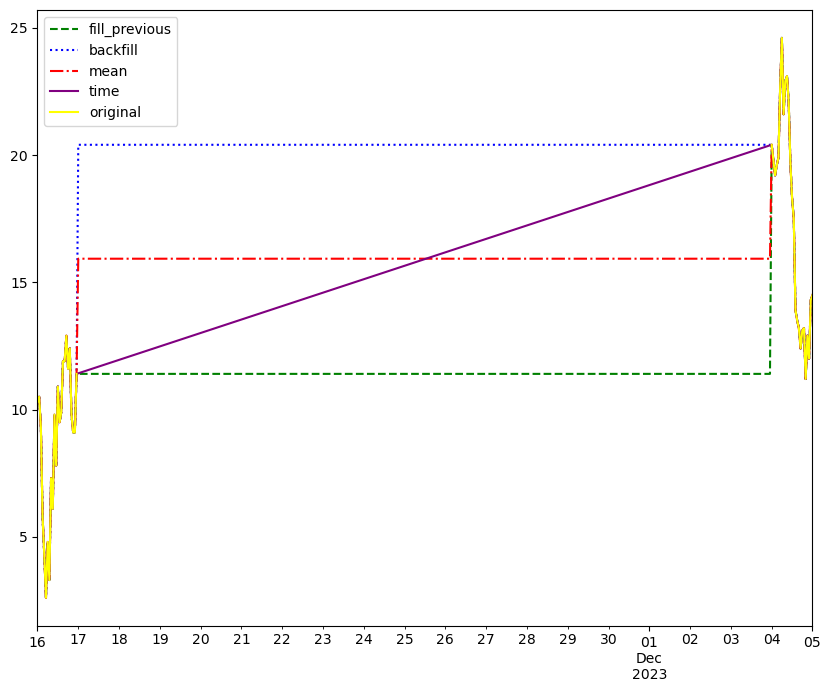

In [41]:
# try ffiiling the missing values with the previous value
missing_data["fill_previous"] = missing_data["windspeed"].fillna(method='ffill')
missing_data["backfill"] = missing_data["windspeed"].fillna(method='bfill')
missing_data["mean"] = missing_data["windspeed"].fillna(colchester_df["windspeed"].mean())
missing_data["time"]=missing_data["windspeed"].interpolate(method='time')
#plot
fig, ax = plt.subplots(figsize=(10,8))
missing_data["fill_previous"].plot(ax=ax,linestyle='--',color="green", label="fill_previous")
missing_data["backfill"].plot(ax=ax,linestyle=':',color="blue", label="backfill")
missing_data["mean"].plot(ax=ax,linestyle='-.',color="red", label="mean")
missing_data["time"].plot(ax=ax,linestyle='-',color="purple", label="time")
missing_data["windspeed"].plot(ax=ax,linestyle='-',color="yellow", label="original")
plt.legend()
plt.show()

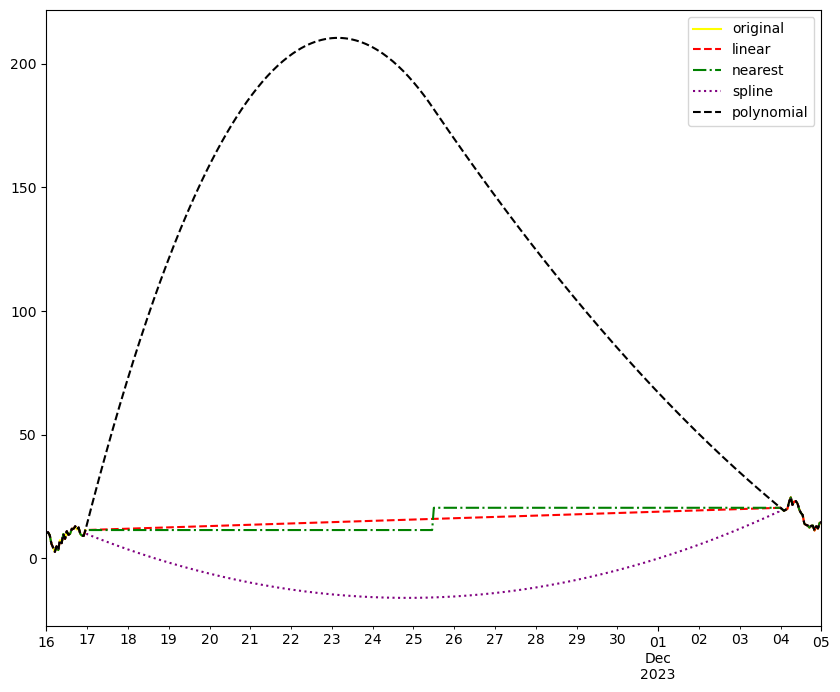

In [42]:
# lets fill missing values with interpolation, we are going to try different methods on the windspeed and plot them to see which one fits better
missing_data['linear'] = missing_data['windspeed'].interpolate(method='linear')
missing_data['nearest'] = missing_data['windspeed'].interpolate(method='nearest')
missing_data['spline'] = missing_data['windspeed'].interpolate(method='spline', order=2)
missing_data['polynomial'] = missing_data['windspeed'].interpolate(method='polynomial', order=2)

#plot
fig, ax = plt.subplots(figsize=(10,8))
missing_data['windspeed'].plot(ax=ax, color="yellow",label='original')
missing_data['linear'].plot(ax=ax,  linestyle='--', color='red',label='linear')
missing_data['nearest'].plot(ax=ax, linestyle='-.', color='green', label='nearest')
missing_data['spline'].plot(ax=ax,linestyle=':', color='purple', label='spline')
missing_data['polynomial'].plot(ax=ax,linestyle='--', color='black', label='polynomial') 

ax.legend()
plt.show()

this approaches does not seem to have a good performance in our data since we now the daily periodicity, so we are going to create our own interpolation function adapted to our needs.

The interpolation function I propose is fill null values with the average of the hour of that specific month, (i.e. if I have missing values in January 3 2024 at 3 pm, fill it with the average of 3 pm in January 2024 ) and if there is no data on that month, use the data of the overal dataset.

This will create the 24 hours periods I know I have in my data, and at the time follow that specific month treand.

In [43]:
def interpolate_columns_with_year_month(df):
    df=df.copy()
    df.index = pd.to_datetime(df.index)
    
    # Apply interpolation logic to each column
    for column in df.columns:
        # Fill within the same year and month for each column
        yearly_monthly_hourly_avg = df.groupby([df.index.year, df.index.month, df.index.hour])[column].transform('mean')
        df[column].fillna(yearly_monthly_hourly_avg, inplace=True)
        
        # Check and fill any remaining NaNs in the column
        if df[column].isna().any():
            # Calculate the overall hourly average for the column as a fallback
            overall_hourly_avg = df.groupby(df.index.hour)[column].transform('mean')
            
            for time, _ in df[df[column].isna()].iterrows():
                df.at[time, column] = overall_hourly_avg[time.hour]
    
    return df

In [41]:
#lets test the function
interpolation = interpolate_columns_with_year_month(missing_data)
interpolation.head()

,windspeed,temp,sealevelpressure,windpower
2023-11-16 00:00:00,10.3,5.1,1016.7,710987.190686
2023-11-16 01:00:00,10.5,4.3,1016.4,760064.611864
2023-11-16 02:00:00,9.3,4.7,1015.6,465600.084794
2023-11-16 03:00:00,5.8,4.6,1015.3,54420.637264
2023-11-16 04:00:00,4.3,4.8,1014.5,0.000000


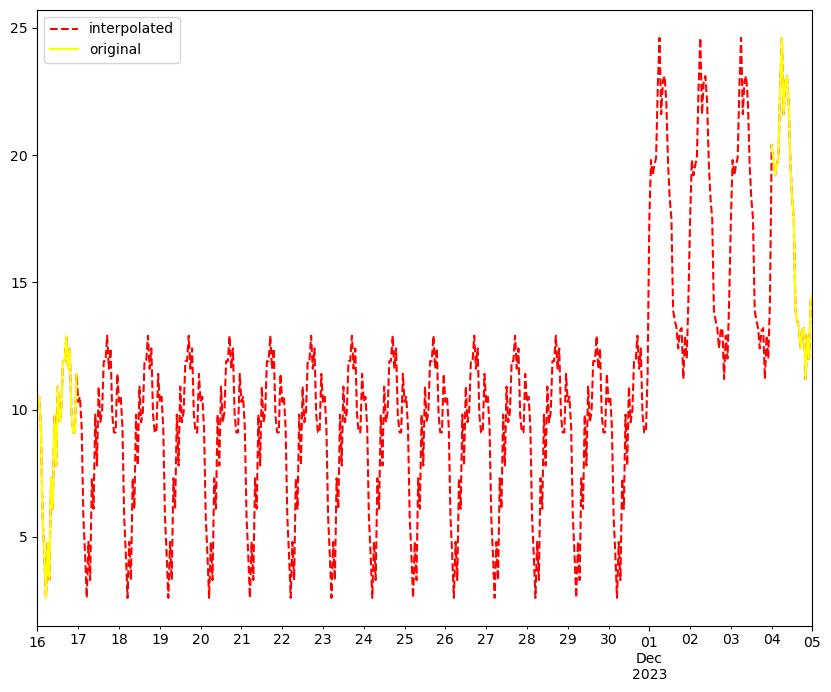

In [19]:
#plot the original and the interpolated data
fig, ax = plt.subplots(figsize=(10,8))
interpolation['windspeed'].plot(ax=ax, linestyle='--', color='red',label='interpolated')
missing_data['windspeed'].plot(ax=ax, color="yellow",label='original')
ax.legend()
plt.show()

Since we are using just 24 hours before and after the missing data, the days are exactly the same, this will not happen in the whole data, but this is just a preview of how the interpolation will work. 

This methods seems to have a more accurate behaviour than the other approaches we tried, so we are goiing with it.

In [44]:
# we are going to fill the missing values in the whole dataset with the function
colchester_df_full = interpolate_columns_with_year_month(colchester_df_full)
#check if we have any missing values
print("Missing values: ",colchester_df_full.isnull().sum().sum())

Missing values:  0


Seems like we now have our complete data, lets take a quick look of how it looks

In [95]:
#plot the daily data from november 2023 to december 2023 using plotly
fig7 = px.line(colchester_df_full['2023-11':'2023-12'], title='2023 November and December Daily average of all variables in colchester dataset',width=1000, height=600,labels={'value':'Value','variable':'Variables','datetime':'Date'})
fig7.show()

In [96]:
#plot 2023 
fig8 = px.line(colchester_df_full.loc['2023'], title='2023 Daily average of all variables in colchester dataset',width=1000, height=600,labels={'value':'Value','variable':'Variables','datetime':'Date'})
fig8.show()

This approach laks of reality, the data seems fake, so lets try another solution.
Now we are just going to replicate the last same hour we have available in our data set.

In [47]:
def fill_with_last_complete_24h_hours(df):
    df=df.copy()
    for column in df.columns:
        # Create a dictionary to store the last value for each hour
        last_hour_values = {hour: None for hour in range(24)}
        
        for i, row in df.iterrows():
            hour = i.hour
            # If the current row is not missing, update the last known value for its hour
            if not pd.isnull(row[column]):
                last_hour_values[hour] = row[column]
            else:
                # If the current row is missing, try to fill it with the last known value for its hour
                if last_hour_values[hour] is not None:
                    df.at[i, column] = last_hour_values[hour]
                # If there's no known last value for this hour, it remains missing
                # Optionally, you could implement additional logic here for such cases

    return df

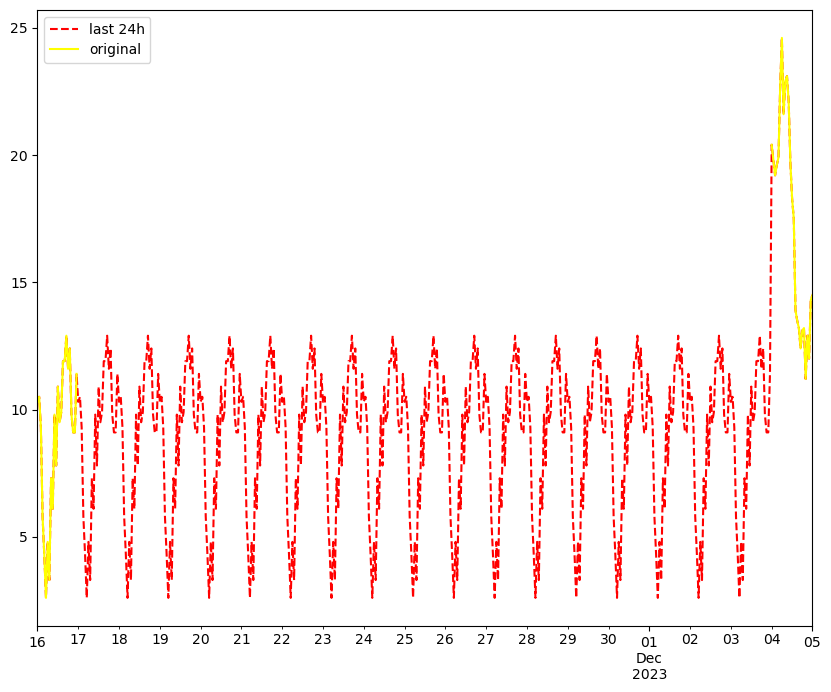

In [29]:
#lets test the function
last_24h = fill_with_last_complete_24h_hours(missing_data)
#plot the original and the interpolated data
fig, ax = plt.subplots(figsize=(10,8))
last_24h['windspeed'].plot(ax=ax, linestyle='--', color='red',label='last 24h')
missing_data['windspeed'].plot(ax=ax, color="yellow",label='original')
ax.legend()

In [66]:
#lets fill the missing values in the whole dataset with the function
colchester_df_full = fill_with_last_complete_24h_hours(colchester_df_full)
#check if we have any missing values
print("Missing values: ",colchester_df_full.isnull().sum().sum())

Missing values:  0


In [67]:
# plot the daily data from november 2023 to december 2023 using plotly
fig9 = px.line(colchester_df_full['2023-11':'2023-12'], title='2023 November and December Daily average of all variables in colchester dataset',width=1000, height=600,labels={'value':'Value','variable':'Variables','datetime':'Date'})
fig9.show()

In [68]:
# plot 2023
fig10 = px.line(colchester_df_full.loc['2023'], title='2023 Daily average of all variables in colchester dataset',width=1000, height=600,labels={'value':'Value','variable':'Variables','datetime':'Date'})
fig10.show()

This approach looks less natural than the other one, so we are going with the first function I create

In [69]:
# lets plot the data again to see if we have any missing values
fig11=px.line(colchester_df_full.resample('D').mean().loc['2023'], title='2023 Daily average of all variables in colchester dataset',width=1000, height=600,labels={'value':'Value','variable':'Variables','index':'Date'})
fig11.show()

the missing values look coherent, they have values inside the normal values of all variables, so we are going to save them

In [45]:
#save dataset to pickle
colchester_df_full.to_pickle("colchester_cleaned_full.pkl")

In [83]:
#load pickle
colchester_df_full = pd.read_pickle("colchester_cleaned_full.pkl")

In [84]:
# create year, month and week columns
colchester_df_full['year'] = colchester_df_full.index.year
colchester_df_full['month'] = colchester_df_full.index.month
colchester_df_full['week_of_year'] = colchester_df_full.index.isocalendar().week
colchester_df_full["hour"]=colchester_df_full.index.hour

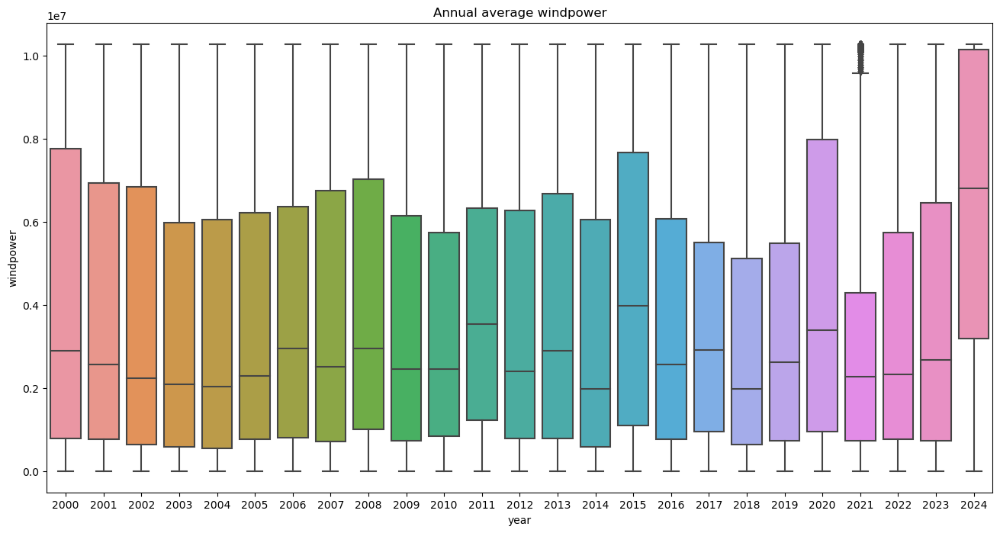

In [53]:
# plot box annually average for windpower 
plt.figure(figsize=(16, 8))
sns.boxplot(data=colchester_df_full, x='year', y='windpower')
plt.title('Annual average windpower')
plt.show()

Observations from the plot:

Trend: Initially, from 2000 to around 2006, there is a noticeable increase in the median wind power generation. After 2006, the median values level off and fluctuate within a certain range without a clear increasing or decreasing trend.

Variability: The variability in wind power generation, as indicated by the height of the boxes and the length of the whiskers, seems to increase over time. Early years show less variability compared to later years.

Recent Years: In the most recent years, specifically around 2023 and 2024, there appears to be a significant increase in both the median and the variability of wind power generation. (This due to the lack of data in 2024)

Outliers: There are several outlier years where the wind power generation was significantly higher or lower than typical. It’s worth investigating what might have caused these anomalies, such as environmental factors.

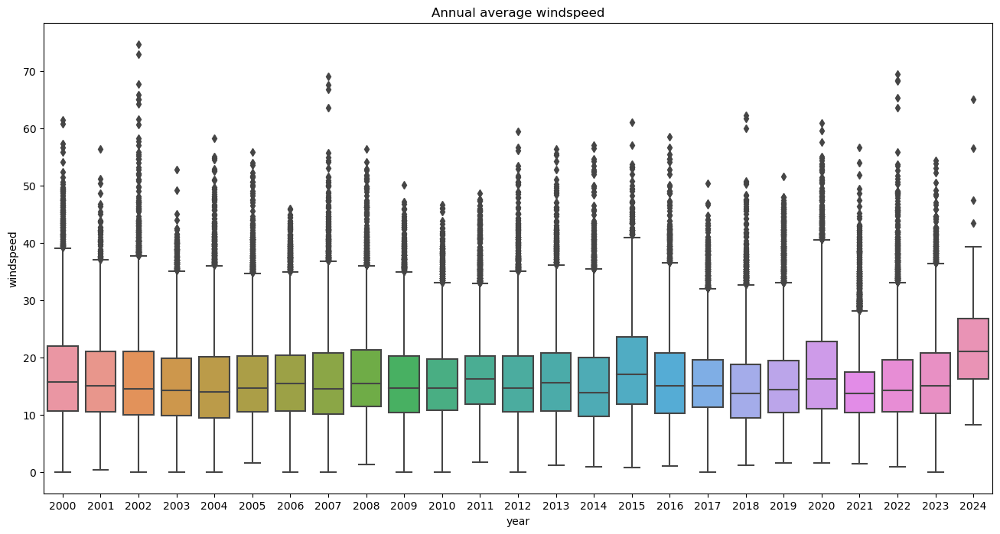

In [54]:
# plot box annually average for windspeed
plt.figure(figsize=(16, 8))
sns.boxplot(data=colchester_df_full, x='year', y='windspeed')
plt.title('Annual average windspeed')
plt.show()

we can see that 2024 is very high because we have very few days of data of this year, so it is biased, therefore is not a comparable average. We are now just to focus on windpower since it is directly related with windspeed, so the metrics are going to have the same behaviour

In [7]:
colchester_df_full.head()

,windspeed,temp,sealevelpressure,windpower,year,month,week_of_year,hour
2000-01-01 00:00:00,9.4,5.9,1020.6,4.901388e+05,2000,1,52,0
2000-01-01 01:00:00,15.1,6.4,1020.4,2.570771e+06,2000,1,52,1
2000-01-01 02:00:00,13.9,6.6,1020.5,1.921775e+06,2000,1,52,2
2000-01-01 03:00:00,14.1,7.2,1020.5,2.023435e+06,2000,1,52,3
2000-01-01 04:00:00,14.3,7.2,1020.4,2.132902e+06,2000,1,52,4


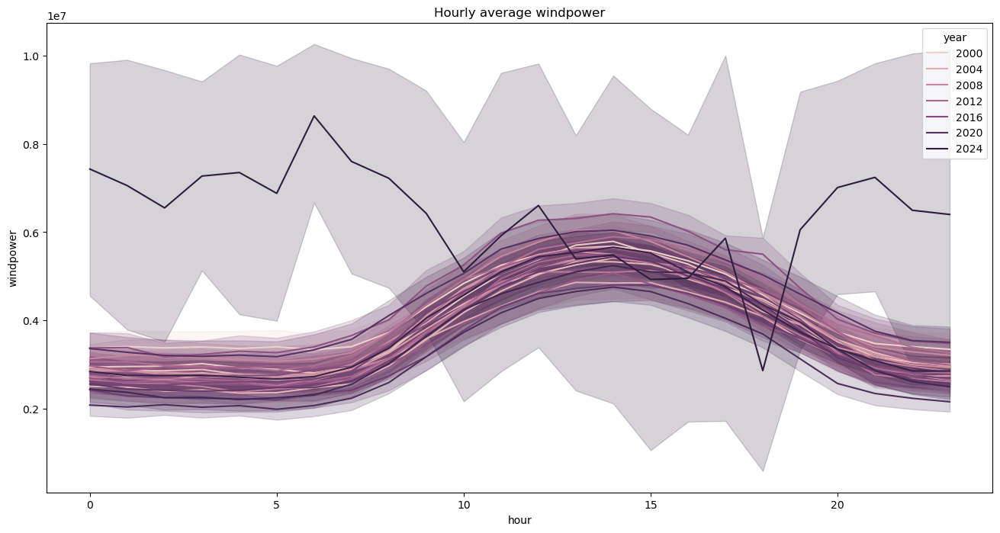

In [8]:
# visualize trends across a day for windpower
plt.figure(figsize=(16, 8))
sns.lineplot(data=colchester_df_full, x='hour', y='windpower', hue='year')
plt.title('Hourly average windpower')
plt.show()

Interpretation of the plot:

Trends over the Day: There is a cyclical pattern observed in wind power generation that seems to repeat daily. For all years, wind power generation starts lower in the early hours, increases as the day progresses, peaks in the afternoon or early evening, and then declines towards the night.

Yearly Changes: The lines for different years show that the pattern of wind power generation throughout the day remains fairly consistent over the years, but the magnitude of generation has changed. Some years show higher overall wind power generation than others.

Variability: The width of the shaded areas around each line represents variability. A wider area suggests more variability in wind power generation during that hour across the year in question. For example, the year represented by the black line (2024) shows much higher variability in the evening hours compared to other years.

Anomalies and Outliers: The year 2024 and represented by the dark line, show anomalies where the average wind power generation is significantly higher or lower than during other years, especially in the evening hours.

Comparison between Years: There is a visible increase in both the average and variability of wind power generation in later years (such as 2020 and 2024) compared to earlier years (like 2000 and 2004). This could suggest changes in weather patterns over time.

Seasonal Effects: The differences between years could also indicate varying weather conditions, such as windier or less windy years.

Overall Increase in Wind Power: There seems to be a general trend of increasing wind power generation over the years, as seen by the higher averages in the more recent years.


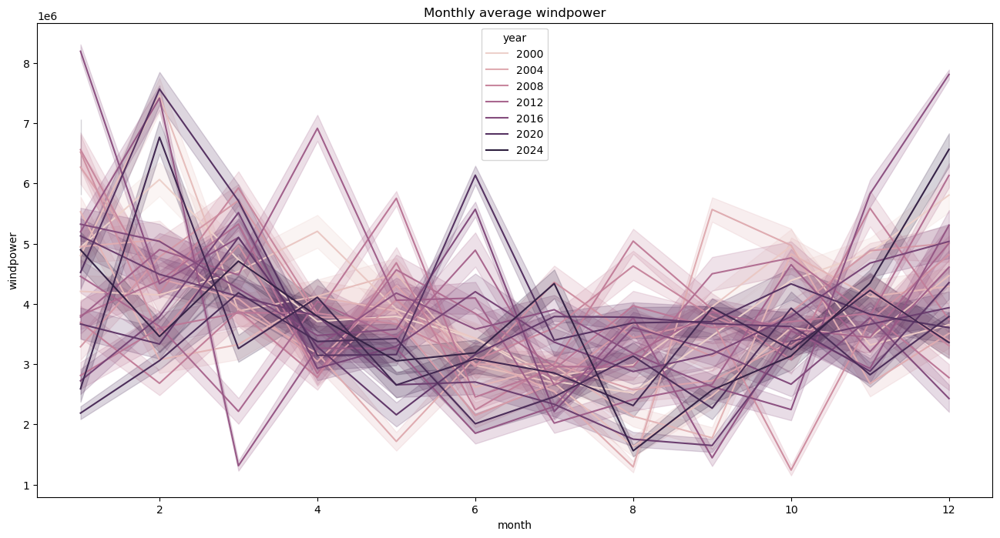

In [56]:
# visualize trends across the year for windpower
plt.figure(figsize=(16, 8))
sns.lineplot(data=colchester_df_full, x='month', y='windpower', hue='year')
plt.title('Monthly average windpower')
plt.show()

Interpretation of the plot:

Seasonal Patterns: The plot shows clear seasonal patterns, with peaks and troughs that correspond to different months. This suggests that wind power generation is subject to seasonal influences, which could be due to weather patterns that affect wind speeds.

Yearly Trends: Each line represents a year, and the lines fluctuate in a similar seasonal pattern annually. However, there is considerable variation in the magnitude of wind power generation between years. Some years peak higher or have deeper troughs than others.

Variability: The shaded areas around the lines represent Variability within the monthly averages. A wider shaded area suggests more variability in wind power generation for that month across different years.

Inter-annual Variability: There is significant inter-annual variability in wind power generation. For example, certain years (like the ones represented by darker lines) show higher peak generation compared to others.

Recent Years' Performance: The most recent years, particularly the line for 2024, show high variability with some of the highest peaks, indicating that wind power generation has possibly increased in capacity and volatility. (Take on account we have very few data of this year)

General Increase Over Time: Comparing the earliest years (lighter lines) to the latest years (darker lines), there appears to be a general increase in wind power generation over time, suggesting an upward trend in capacity or efficiency.

Anomalies: There are certain months, particularly toward the middle of the year, where there is a wider variation between the years, suggesting that certain months may have more unpredictable wind conditions.

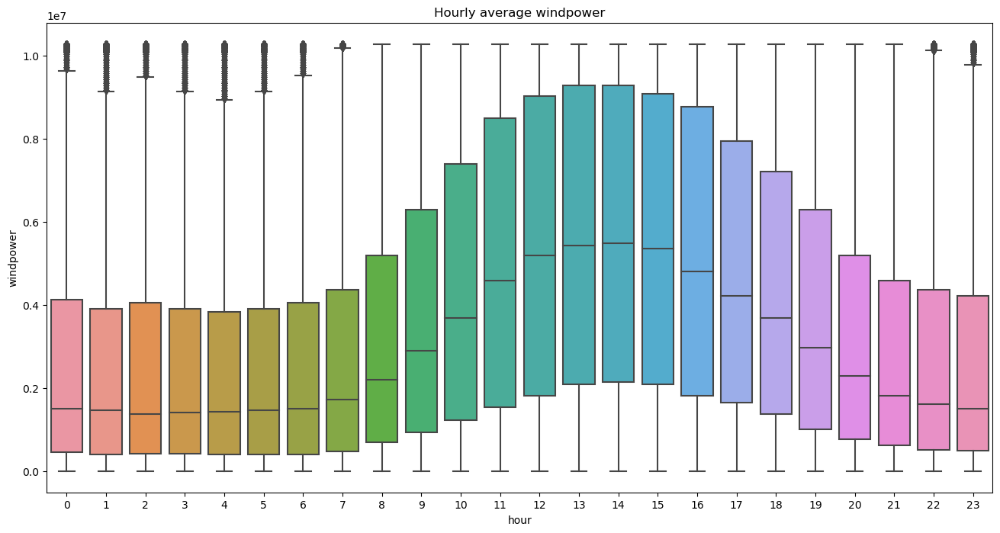

In [9]:
# visualize trends across the day for windpower using box plots
plt.figure(figsize=(16, 8))
sns.boxplot(data=colchester_df_full, x='hour', y='windpower')
plt.title('Hourly average windpower')
plt.show()

From the plot, we can observe the following:

Variability: There is a variation in both median values and the spread (IQR) across different hours. Some hours have a wider spread of values (larger boxes), suggesting greater variability in wind power generation during these times.

Trend: There seems to be a cyclical pattern where wind power generation is higher during certain hours. The median values are higher in the afternoon and evening (hours 12 to 18), and lower during late night and early morning (hours 0 to 6). This could correspond to the natural wind patterns or the demand cycles for power.

Outliers: There are several outliers at various hours, indicating occasional values that were significantly higher or lower than typical for those hours.

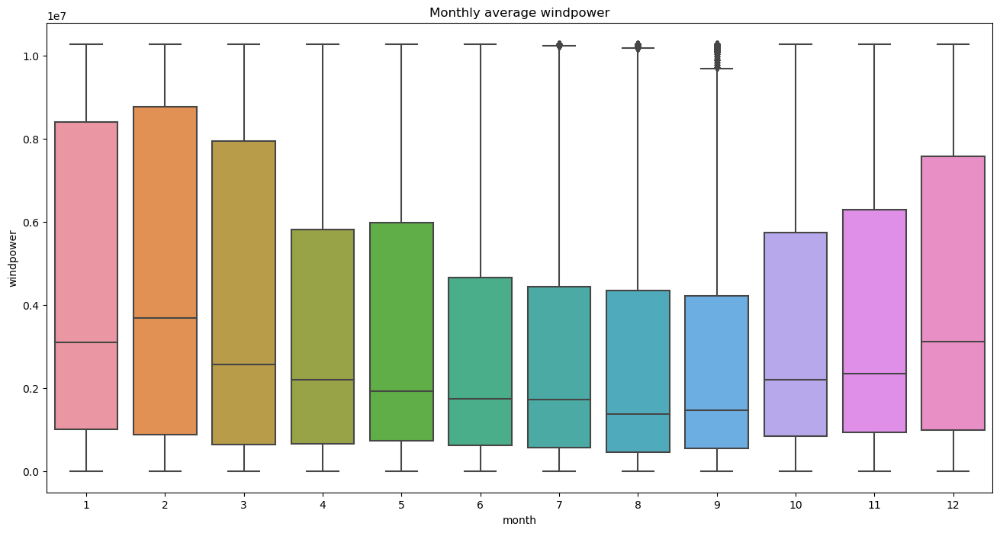

In [219]:
# visualize trends across the year for windpower using box plots
plt.figure(figsize=(16, 8))
sns.boxplot(data=colchester_df_full, x='month', y='windpower')
plt.title('Monthly average windpower')
plt.show()

with this two plots we can reinforce the conclusions of the last plots. 

Lets now take a look in historical surplus of energy production, taking on account our base assumptions:

In [89]:
#add a column weather there was a surplus of energy or not class 0 rpresents NO surplus and 1 represents surplus
colchester_df_full['is_surplus'] = np.where(colchester_df_full['windpower'] > 3082500, 1, 0)
#proportion of surplus
print("Proportion of surplus: ",colchester_df_full['is_surplus'].value_counts(normalize=True))


Proportion of surplus:  is_surplus
0    0.550107
1    0.449893
Name: proportion, dtype: float64


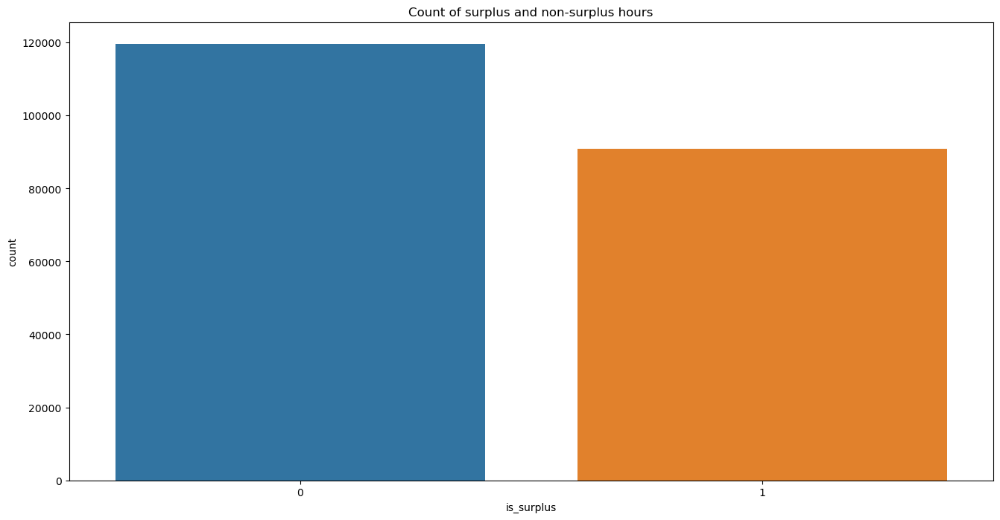

In [81]:
#bar plot for the is_surplus classes
plt.figure(figsize=(16, 8))
sns.countplot(data=colchester_df_full, x='is_surplus')
plt.title('Count of surplus and non-surplus hours')
plt.show()


We can see that is very likely to have a surplus of energy, now lets see across time.

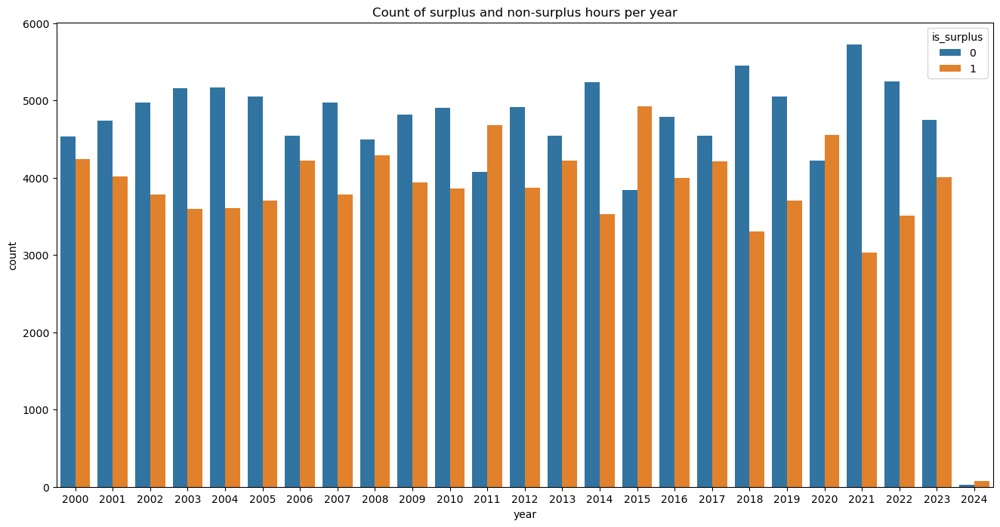

In [88]:
#plot surplus and non-surplus hours for each year
plt.figure(figsize=(16, 8))
sns.countplot(data=colchester_df_full, x='year', hue='is_surplus')
plt.title('Count of surplus and non-surplus hours per year')
plt.show()


Observations from the plot include:

Trend of Surplus Hours: There is a fluctuating pattern in the number of surplus hours each year. It does not show a clear upward or downward trend over the years but does exhibit significant year-to-year variation.

Trend of Non-Surplus Hours: The count of non-surplus hours also fluctuates annually, and similarly to the surplus hours, it does not display a clear long-term trend.

Comparison Between Surplus and Non-Surplus Hours: In most years, the count of non-surplus hours exceeds the count of surplus hours, indicating that surplus situations are less common than non-surplus situations.

Recent Years: In the most recent years (2022, 2023, and 2024), there is a noticeable increase in both surplus and non-surplus hours compared to some earlier years. This could suggest changes in wind speed and temperature conditions.

Inter-annual Variability: There is significant inter-annual variability in both surplus and non-surplus hours, which could be influenced by a variety of factors weather conditions.

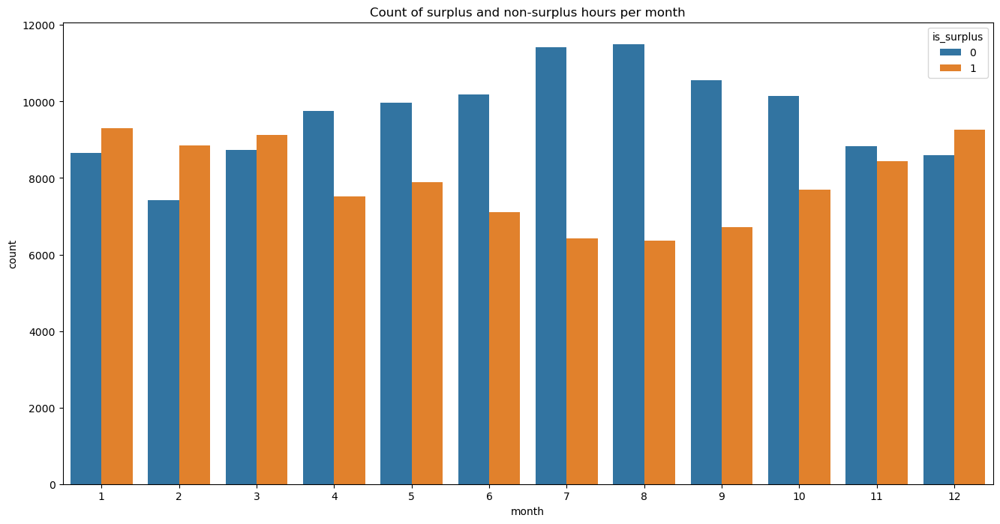

In [90]:
#plot surplus and non-surplus hours for each month
plt.figure(figsize=(16, 8))
sns.countplot(data=colchester_df_full, x='month', hue='is_surplus')
plt.title('Count of surplus and non-surplus hours per month')
plt.show()

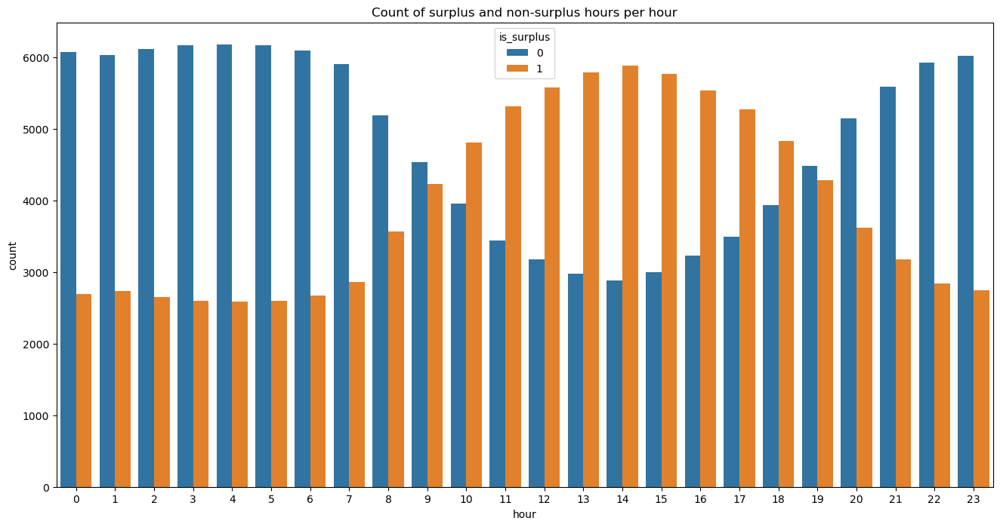

In [91]:
#plot surplus and non-surplus hours for each day
plt.figure(figsize=(16, 8))
sns.countplot(data=colchester_df_full, x='hour', hue='is_surplus')
plt.title('Count of surplus and non-surplus hours per hour')
plt.show()

As expected we are having more surplus of energy within the peak hours of power production. However, we can have surplus energy all over a day.

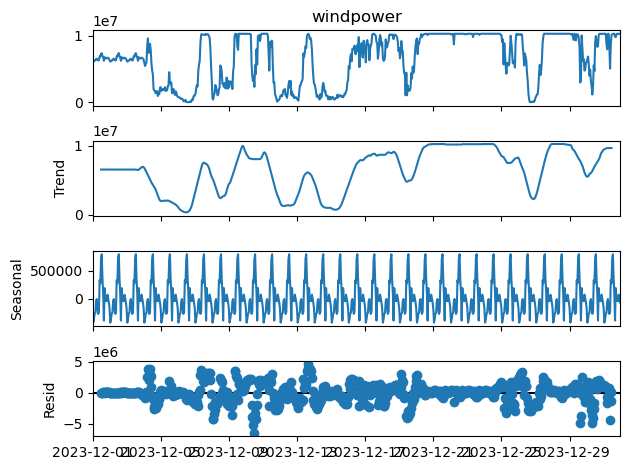

In [12]:
#lets decompose our time series to see the trend, seasonality and residuals using monthly average of windpower
decomposition = seasonal_decompose(colchester_df_full['windpower'].loc['12-2023'], model='additive')
fig = decomposition.plot()
plt.show()

With a "zoom" on the data (just focus on a month).

Top Plot - Original Time Series (Windpower): This is the actual observed time series data for wind power generation. The data shows significant fluctuations within the mont.

Second Plot - Trend Component: The trend component smooths out the data to show the underlying trend in wind power generation over the month. It appears to have a somewhat regular pattern of rises and falls, which might correspond to expected variations in wind speed fluctuations throughout the month.

Third Plot - Seasonal Component: The seasonal component captures regular, periodic fluctuations within the time series data, which repeat over a day. The pattern repeats with a regular frequency, indicating a daily cycle in the wind power generation, which might correspond to diurnal patterns in wind speed.

Bottom Plot - Residual Component: The residuals represent the portion of the time series that is not explained by the trend and seasonal components. This is essentially the noise or random variation left over once the other two components have been accounted for. In this case, the residuals appear to be quite volatile, suggesting that many hourly fluctuations in wind power generation are not captured by the trend or seasonal components. This could be due to unpredictable factors affecting wind power, such as sudden changes in weather conditions.

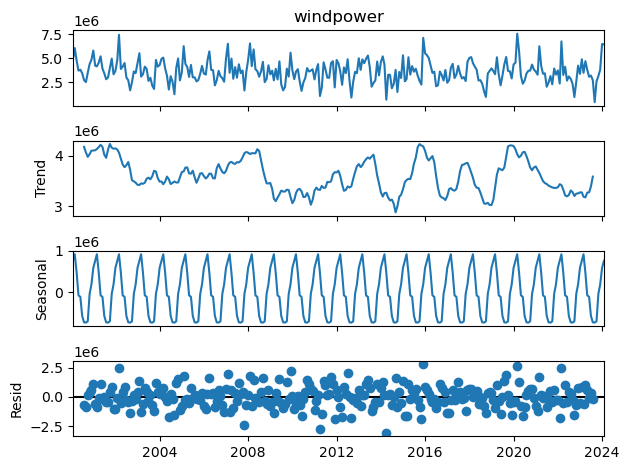

In [221]:
#lets decompose our time series to see the trend, seasonality and residuals using monthly average of windpower
decomposition = seasonal_decompose(colchester_df_full['windpower'].resample('M').mean(), model='additive')
fig = decomposition.plot()
plt.show()


With monthly data there is no clear trend, in any part of the timeseries, and we have a seasonality which are the months we also have too much resid.
From previous plots and this we can deduce:

* Day seasonality
* Year seasonality
* All years have had different monthly behaviour, but very similar days (hours).

In [227]:
# Statistical test for stationarity: Augmented Dickey-Fuller (ADF) test
adf=adfuller(colchester_df_full['windpower'])
print("ADF test statistic: ",adf[0])
print("p-value: ",adf[1])

ADF test statistic:  -36.79956567106274
p-value:  0.0


p-value < 0.05 dont have aunit root and can be stationary. In our case we saw periodicty in the previous plots, therefore we are not going to consider the results from this test.

In [70]:
# lets make our data to be stationary
# we are going to use the differencing method
colchester_df_full['windpower_diff'] = colchester_df_full['windpower'].diff()

In [71]:
# fill null windpower_diff with 0
colchester_df_full['windpower_diff'] = colchester_df_full['windpower_diff'].fillna(0)

In [72]:
#plot using plotly
fig12 = px.line(colchester_df_full, x=colchester_df_full.index, y='windpower_diff', title='Differenced windpower',width=1000, height=600,labels={'windpower_diff':'Differenced windpower','index':'Date'})
fig12.show()

Now our data is stationary and we can proceed to plot autocorrelations

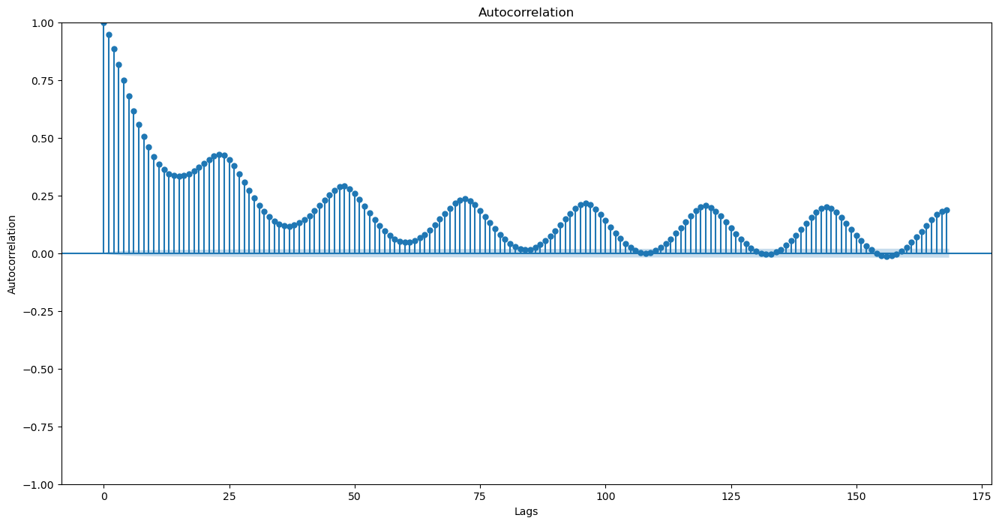

In [12]:
# we are now going to plot autocorrelation and partial autocorrelation
from statsmodels.graphics.tsaplots import plot_acf, plot_pacf
fig, ax = plt.subplots(figsize=(16,8))
plot_acf(colchester_df_full['windpower'], ax=ax, lags=168)
plt.xlabel('Lags')
plt.ylabel('Autocorrelation')
plt.show()


This autocorrelation has a slowly decay, which can be a sign of a trend or changing variance in the series. The autocorrelation at lag x reflects not only the direct correlation at lag x but also the influence of the data's trend or changing variance structure.

That is why we are doing autocorrelation an partial correlation plots with the stationary data.

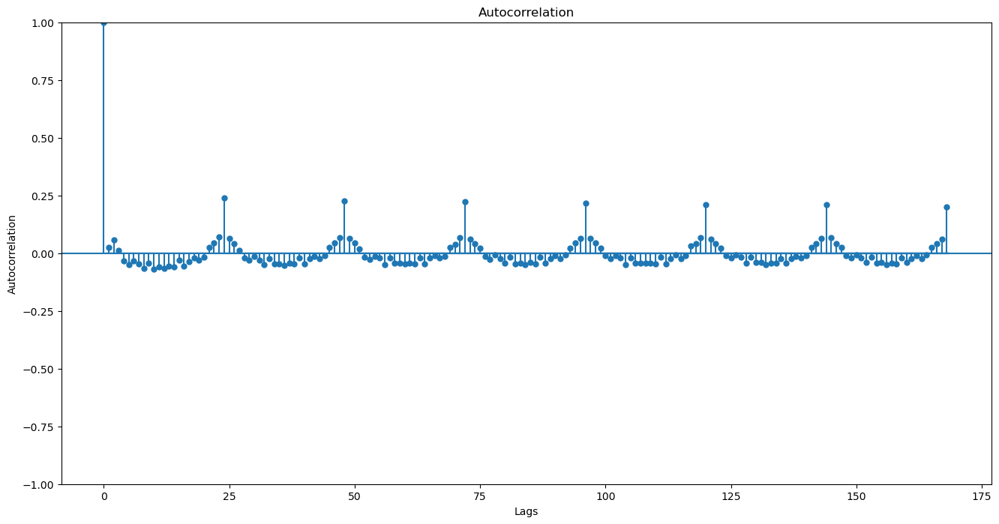

In [73]:
fig, ax = plt.subplots(figsize=(16,8))
plot_acf(colchester_df_full['windpower_diff'], ax=ax, lags=168,alpha=0.05)
plt.xlabel('Lags')
plt.ylabel('Autocorrelation')
plt.show()

The autocorrelation at lag 0 is always 1, because the data series is perfectly correlated with itself at that point.

Decay Pattern: The plot shows a sinusoidal-like pattern of decay in the autocorrelation coefficients as the lag increases. This suggests that there is a cyclical pattern in the data with a periodicity reflected in the autocorrelation plot.

Cyclicity: The repeated peaks and troughs suggest a regular, repeating cycle in the time series data. The cycle appears to complete every 24 hours.

Significant Lags: The autocorrelation coefficients that stand out above the confidence bounds indicate significant autocorrelations at those lags. In this case the confidence level is not perceptible, so all are significant.

Negative Autocorrelation: Some lags show negative autocorrelation, which implies an inverse relationship at those lags; when the time series is above the mean, the values at these lags are below the mean, and vice versa.

Implications for Forecasting: The presence of significant autocorrelation at multiple lags suggests that past values (specifically at the lagged times where the peaks occur) have a predictive quality for future values. This could be leveraged in the forecasting model.

Need for Seasonal Adjustment: The cyclical nature of the autocorrelation may require a seasonal adjustment or a model that can account for seasonality, such as SARIMA (Seasonal ARIMA).

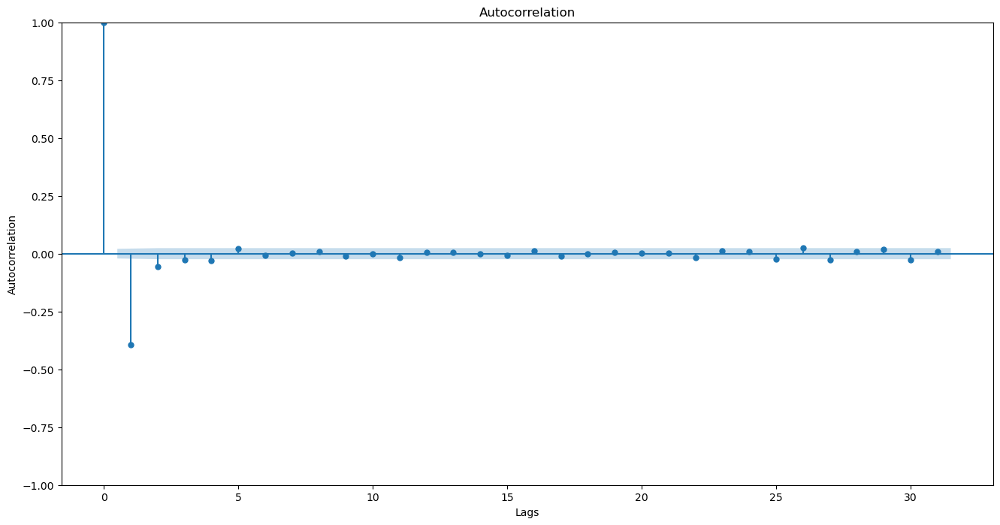

In [15]:
#daily average autocorraltion considering a month
fig, ax = plt.subplots(figsize=(16,8))
plot_acf(colchester_df_full['windpower_diff'].resample("D").mean(), ax=ax, lags=31)
plt.xlabel('Lags')
plt.ylabel('Autocorrelation')
plt.show()

Initial Negative Spike: There is a significant negative autocorrelation at the first lag. This indicates that the value at one day is, on average, negatively correlated with the value in the previous day. In practical terms, if the time series shows an increase in one day, it is likely to show a decrease in the next day, and vice versa.

Subsequent Lags: Beyond the initial lag, all other autocorrelations fall within what appears to be a very narrow confidence interval around zero. This suggests that there are no significant correlations at lags beyond the first day.

Implications for Modeling: The lack of significant autocorrelation at lags beyond the first suggests that past values do not have a strong linear predictive power for future values after more than one day has passed. This would imply that an autoregressive model for this time series may not need to include many past values.

Randomness: The rapid fall-off to near-zero autocorrelation from the second lag onwards suggests that the time series may resemble a random walk or white noise process, particularly because there is no pattern of decay or seasonal effect evident in the subsequent lags.

Stationarity: The plot could indicate that the time series is stationary, as there is no gradual decay or trend in the autocorrelations. 



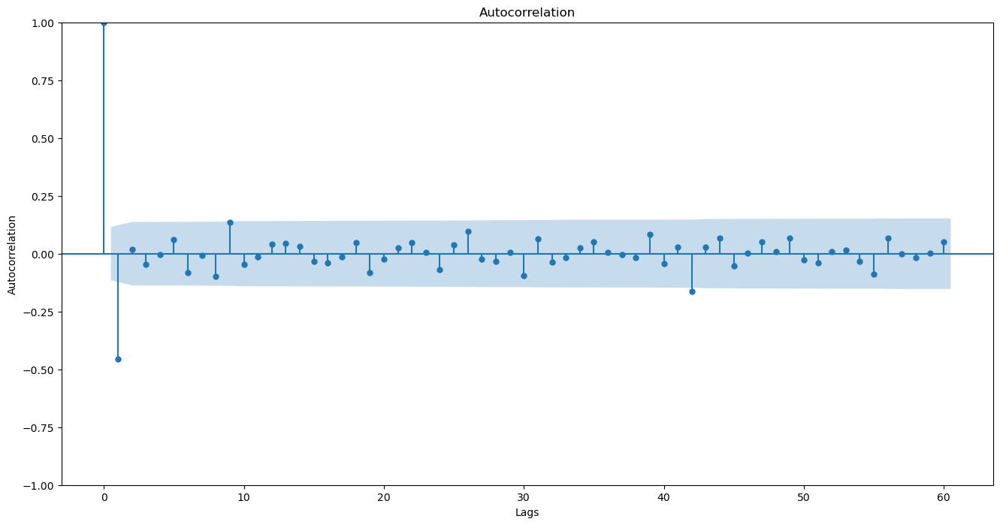

In [16]:
# monthly average autocorraltion considering 5 years
fig, ax = plt.subplots(figsize=(16,8))
plot_acf(colchester_df_full['windpower_diff'].resample("M").mean(), ax=ax, lags=60)
plt.xlabel('Lags')
plt.ylabel('Autocorrelation')
plt.show()

Initial Sharp Drop: There is a significant negative autocorrelation at lag 1, just like in the previous plot. 

Subsequent Lags: Beyond the first lag, the autocorrelation coefficients are mostly within the confidence interval band (the shaded area around the zero line), which suggests there are no significant autocorrelations for lags beyond 1 month. This means that the values of the time series at these lags do not show a linear relationship with past values.

Randomness: The autocorrelation values hovering around zero with no discernible pattern for higher lags suggest that the series may be similar to a random walk or noise, especially because there is no consistent or significant autocorrelation detected.

Stationarity: The lack of a pattern in the autocorrelations for lags higher than 1 is due to the forced stationarity.


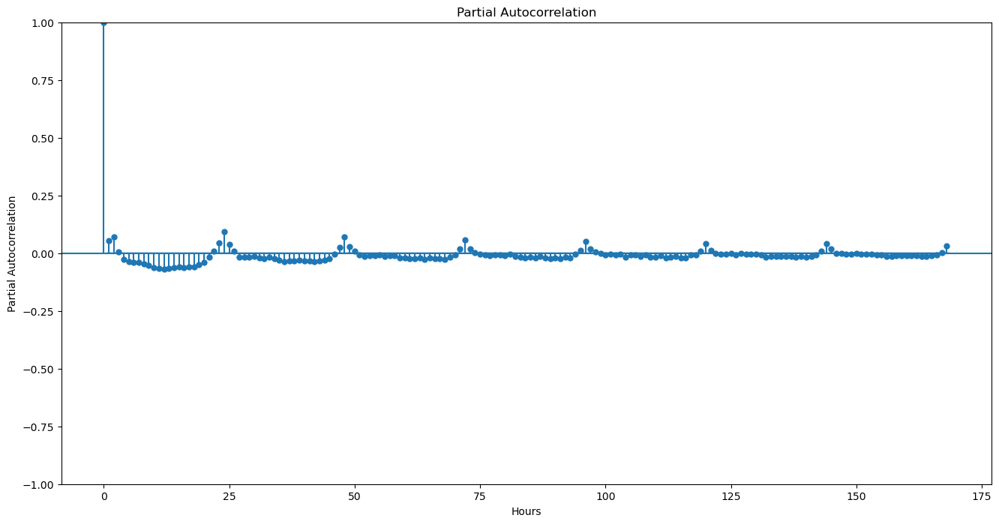

In [18]:
#plot partial autocorrelation
fig, ax = plt.subplots(figsize=(16,8))
plot_pacf(colchester_df_full['windpower_diff'], ax=ax,lags=168)
plt.xlabel('Hours')
plt.ylabel('Partial Autocorrelation')
plt.show()


Significant Lags: The significant spikes (either above or below the zero line) in the plot represent lags where there is a significant partial autocorrelation after controlling for the autocorrelation at all shorter lags. However, without horizontal lines indicating the confidence bounds, we cannot definitively say which spikes are statistically significant.

Damped Oscillations: The PACF values show a pattern of damped oscillations, which dampen out as lags increase. This suggests that the direct correlation between two points separated by k lags decreases as k increases.

Model Selection: In time series modeling, particularly for ARIMA models, significant lags in a PACF plot indicate potential orders for the autoregressive (AR) part of the model. In this plot, without the confidence bounds, it's hard to pinpoint exactly which lags would be considered significant, but it looks like beyond the first few lags, the partial autocorrelations are fairly close to zero, suggesting a low-order AR model might be appropriate.

Stationarity: The fact that the partial autocorrelations are not slowly tapering off but rather cut off fairly quickly after the first few lags is due to the forced stationarity.

Noise: The PACF values that hover around zero (within the bounds of confidence intervals, which are not visible here) suggest that there is little to no direct relationship between the values at those lags, implying that the series may have noise-like properties.

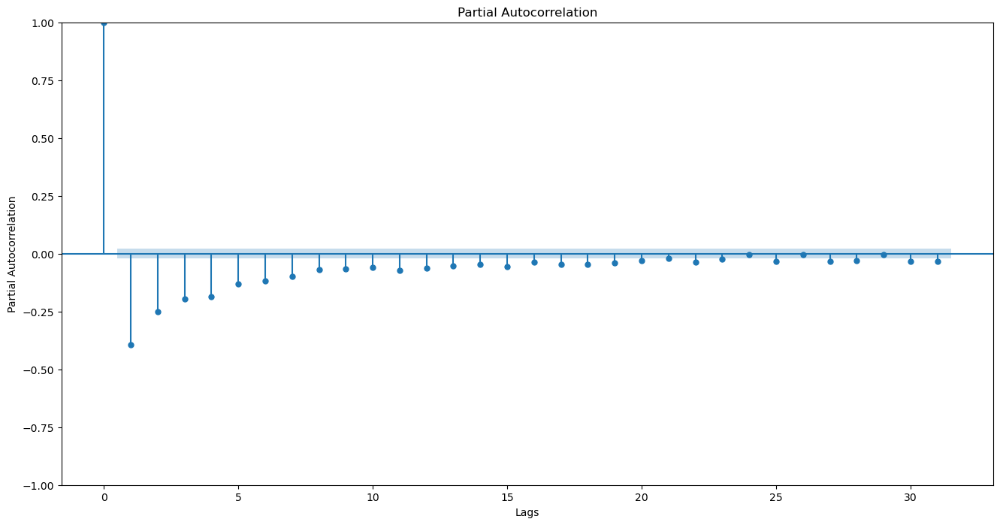

In [19]:
# daily average partial autocorraltion considering a month
fig, ax = plt.subplots(figsize=(16,8))
plot_pacf(colchester_df_full['windpower_diff'].resample("D").mean(), ax=ax, lags=31)
plt.xlabel('Lags')
plt.ylabel('Partial Autocorrelation')
plt.show()

Significant Lags: The plot indicates a significant negative partial autocorrelation at lag 1. This suggests that, after accounting for the intervening values, there is a significant inverse relationship between a value and the value from the previous day.

Subsequent Lags: The partial autocorrelations for lags beyond the first are all very close to zero and show no significant spikes. This indicates that there are no direct correlations between the current value and past values that are not already explained by the first lag.

Model Selection: In the context of ARIMA modeling, a significant negative partial autocorrelation at lag 1 suggests that an AR(1) model may be appropriate. This means that the current day's value is likely to be negatively correlated with the previous day's value, after adjusting for the values in between.

Stationarity: The PACF plot does not show a gradual decline in the partial autocorrelation values due to the forced stationarity.

Noise: Beyond the first lag, the series exhibits partial autocorrelations around zero, which suggests that the time series may resemble white noise after the first lag.

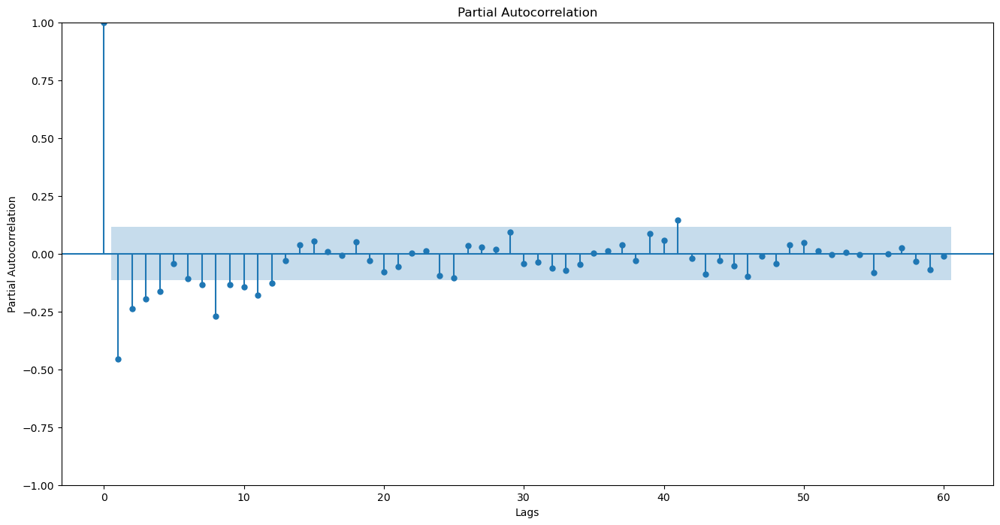

In [20]:
# monthly average partial autocorraltion considering 5 years
fig, ax = plt.subplots(figsize=(16,8))
plot_pacf(colchester_df_full['windpower_diff'].resample("M").mean(), ax=ax, lags=60)
plt.xlabel('Lags')
plt.ylabel('Partial Autocorrelation')
plt.show()

Significant Lags: The first few lags below the zero line indicate a significant negative partial autocorrelation. 

Negative Correlation at Lag 1: The significant negative partial autocorrelation at lag 1 suggests a negative relationship between a given month's value and the value from the previous month, after accounting for the values in between.

Subsequent Lags: The partial autocorrelations for the subsequent lags appear to hover around zero, indicating no significant partial autocorrelation at those lags. This suggests that there is no direct linear relationship between the current value and past values beyond the first lag.

Noise: Beyond the initial negative correlation, the near-zero partial autocorrelations suggest that there may be no further autoregressive structure in the data, and it could be well-described by a random process (noise) after accounting for the first lag.

## Data splitting

Our final task is going to predict windpower for the next 24-48 hours, so we are going to determine is this prediction is below or above the treshold we define.
We are going to use data from 2024 as test set, data of 2023 as validation set and data from 2000 to 2022 as train set, to try different models and paramteres.
(We are going to keep granularity (Hours))

In [92]:
df = colchester_df_full["windpower"].to_frame()
df.head()

,windpower
2000-01-01 00:00:00,4.901388e+05
2000-01-01 01:00:00,2.570771e+06
2000-01-01 02:00:00,1.921775e+06
2000-01-01 03:00:00,2.023435e+06
2000-01-01 04:00:00,2.132902e+06


In [93]:
#split the data into train and test an validate train is going to be until 2022
train = df.loc['2000':'2022']
validate = df.loc['2023']
test = df.loc['2024']
print("Train shape: ",train.shape, "dates from: ",train.index.min()," to: ",train.index.max())
print("Validate shape: ",validate.shape, "dates from: ",validate.index.min()," to: ",validate.index.max())
print("Test shape: ",test.shape, "dates from: ",test.index.min()," to: ",test.index.max())


Train shape:  (201624, 1) dates from:  2000-01-01 00:00:00  to:  2022-12-31 23:00:00
Validate shape:  (8760, 1) dates from:  2023-01-01 00:00:00  to:  2023-12-31 23:00:00
Test shape:  (106, 1) dates from:  2024-01-01 00:00:00  to:  2024-01-05 09:00:00


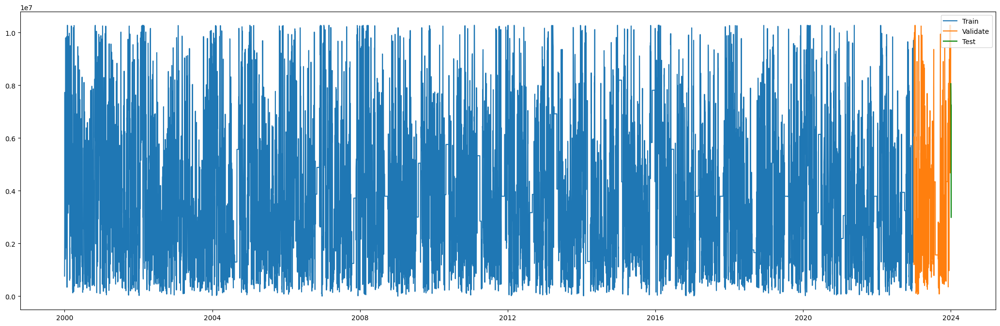

In [94]:
# plot with different colors train, test and validate
plt.figure(figsize=(26, 8))
plt.plot(train.resample('D').mean(), label='Train')
plt.plot(validate.resample('D').mean(), label='Validate')
plt.plot(test.resample('D').mean(), color="green",label='Test')
plt.legend()
plt.show()

This split may change, it may deppend in the model selected and experimentation.